# London Serious Crime Data (Overview)
Our objective is to assess whether using official sources of socio economic, demographic, crime and policing data at local area level, that youth violent crime is more highly correlated with deprivation than levels of policing and crime cleanup rates in London. We therefore need need youth violent crime data at a low level of granularity (LSOA) and the purpose for this notebook is to produce that data. 

## Available crime data sources
The London Assembly analysis produced violent crime data by aggregating Metropolitan Police serious youth violence crime offences, British Transport Police violent crime offences, London Ambulance assault call-outs and hospital A&E data and admission episodes for assault ( https://data.london.gov.uk/dataset/a-public-health-approach-to-serious-youth-violence - 04d Appendix B - Data pack 2018). The reason for using these additional sources is because they believe that only 50% of serious youth violence offences were reported to the police. Using these additional sources creates a fuller picture of serious youth violence. 

Unfortunately, it is not possible to recreate this dataset because ambulance callout and hospital A&E data is sensitive data and not publicly available at the level of granularity we require. We contacted CityIntelligence, owner of the London Data Store on May 20th 2021 to request access to their data but did not receive a response. Furthermore, even if we could access this data, we do not have the means to cross reference which cases have also been captured within Police reported crime data and so there would be a significant risk of double counting. For this reason we chose to rely solely on police reported crime data.

Police recorded crime data is produced in two forms, firstly the Crime Survey in England & Wales (CSEW), which entails surveys of the victims of crime and secondly in crime statistics collated by the police forces. In discussing Serious Youth Violence ( https://publications.parliament.uk/pa/cm201719/cmselect/cmhaff/1016/1016.pdf ), the Home Affairs Committee of the House of Commons The Crime Survey in England & Wales explain how police collated statistics are their preferred source of serious crime data because, while the CSEW is a better source for more minor crimes, "it is is not very effective at measuring high-harm offences" (page 10). For this reason we will base our violent crime data on crime statistics produced by the police. 

Ideally we would have used the Home Office police data from https://www.gov.uk/government/statistics/police-recorded-crime-open-data-tables as the basis for our crime data as these are considered official statistics. However, this data is only recorded at Police Force Area or Community Safety Partnership level whereas we need crime data at the far more granular LSOA level. This means we need to find alternative sources and the following two present the best available options:
- the London Datastore, which is the central store of all London related data, including crime data https://data.london.gov.uk/dataset/recorded_crime_summary 
- police data available from https://data.police.uk/data/ (we were specifically directed to this site by members of the Home Office crime team, having asked them for LSOA level serious violent crime data).

We chose to analyse both datasets and to choose the dataset which most closely reconciles with the previously analysed Home Office crime dataset, because we know that dataset is internally consistent and considered 'official'.

## Method
In this notebook we perform the following:

### 1. Choose the best source of serious violent crime data
Compare sources of LSOA level serious violent crime data with Home Office data to choose the best source of Crime data. 
- To do this we will create crime snapshots from the London Datastore, Police Data and then compare both with the Home Office data produced in our England and Wales contextual analysis. We will be reconciling data from the financial year 2019.

### 2. Compare data with GLA crime data
Compare chosen crime data with GLA analysis to assess differences in absolute levels and rates of crime
-  To do this we will compare both crime levels and rates for the chosen LSOA level crime source and the results from the GLA analysis. This is to provide an additional reasonableness check for our chosen source. If its crime data is significantly different to the GLA crime data then we need to investigate reasons why.


### 3. Trends in serious violent crime between 2017 and 2019 at borough level
Review trends in LSOA level data, aggregated to borough level, and compare these with trends observed previously at Community Safety Partnership level.
- We have access to historical crime data at LSOA and so it is useful to use that so we can see trends at borough level, having aggregated our LSOA level data. This is because this will show whether the trends we see are similar to those produced previously at Community Safety partnership level (see notebook 1_1_Crime Context England), which in turn will give a level of comfort (or otherwise) that the trend data is reasonable

### 4. London LSOA level contextual analysis
Visually analyse serious violent crime across all LSOA areas both at a point in time, 2019, and how it changes over time. We are looking to understand whether there are any pockets of serious violent crime and whether crime changed consistently between 2017 and 2019 or whether the rates of change were different across different areas.
- We will look at point in time, trends over time and also spatial distribution of crime at LSOA level

### 5. Distribution and Outlier analysis
Assess the distribution of our chosen crime source and identify outliers. We would already have looked into outliers in step 4 to a large extent but this step formalises the process and we will use QQplots to get a more formal view of how crime is distributed. If possible, we want to have as close to normal a distribution of crime for use in later analyses because a number of statistical inference techniques produce spurious results for non normal distritions. We will therefore check for normality, and outliers and choose an appropriate strategy to resolve outliers and look at other transformations, such as log transformations, if removing outliers doesn't resolve non normality in the distribution.

## Output
The output from this notebook will be a crime contextual analysis plus a baseline distribution for serious violent crime at LSOA level in London. This baseline will then be used as our target/dependent variable within the inferential analysis and machine learning performed in later notebooks.
- For the purposes of this research, we want to produce a clean dataset of LSOA level crime for the year 2019 (year starting in April, 2019 and running through to end of March 2020). We specifically chose this period because it is the latest full years worth of data that was not materially affected by the Covid pandemic, which intensified in April 2020. We wanted a later year because that gives more time for any of the Mayors actions (or inactions) to have had an effect on crime figures.

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import altair as alt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
import numpy as np

## 1. Choose the best source for crime data

### First derive the proportion of all serious violent crime from sexual offences using ward level data
Unfortunately, the London Datastore LSOA level police data does not include Sexual Offences, which is one of the crime categories the Home Office includes within their Serious Violent Crime statistics. Fortunately, the London datastore crime data at ward level <b> DOES </b> contain Sexual Offences data and so we will use this dataset to first establish what proportion of Serious Violent Crime is comprised of Sexual Offences. This will allow us to assess whether the absence of this data in the LSOA level data will have material impact on our analysis.
- It should be noted that we could have used Ward data for our analysis but chose not to because it is not sufficiently granular, for example wards comprise on average 13,078 people while LSOAs contain 1,722 (2010 figures, source: https://data.london.gov.uk/dataset/lsoa-atlas#:~:text=The%20LSOA%20atlas%20provides%20a,and%2013%2C078%20for%20a%20ward )

In [2]:
all_crimes = pd.read_excel(".\DataSources\Crime and outcomes\MPS_Ward_Level_Crime_Historic_NewWard (Jan2017 to Dec2018).xlsx",
                           sheet_name='data', usecols="A:E, CI:DF")
print(all_crimes.shape)
all_crimes.head()

(20126, 29)


,WardCode,Ward Name,Borough,Major Category,Minor Category,201701,201702,201703,201704,201705,...,201803,201804,201805,201806,201807,201808,201809,201810,201811,201812
0,E05000026,Abbey,Barking and Dagenham,Burglary,Burglary In A Dwelling,3,1,7,12,12,...,8,5,5,4,6,3,6,6,4,8
1,E05000027,Alibon,Barking and Dagenham,Burglary,Burglary In A Dwelling,4,8,3,5,5,...,7,1,5,3,2,4,4,8,4,10
2,E05000028,Becontree,Barking and Dagenham,Burglary,Burglary In A Dwelling,12,15,4,5,14,...,7,8,6,4,7,3,6,5,10,9
3,E05000029,Chadwell Heath,Barking and Dagenham,Burglary,Burglary In A Dwelling,10,6,7,7,4,...,7,5,8,6,5,4,8,5,10,8
4,E05000030,Eastbrook,Barking and Dagenham,Burglary,Burglary In A Dwelling,2,4,7,2,8,...,5,2,1,2,3,3,6,6,11,2


In [3]:
all_crimes = all_crimes.dropna(how='all') # only drops a row when every column is NA
print(all_crimes.shape)

# Now check for NaN values
nan_values = all_crimes[all_crimes.isna().any(axis=1)]
nan_values

(20126, 29)


,WardCode,Ward Name,Borough,Major Category,Minor Category,201701,201702,201703,201704,201705,...,201803,201804,201805,201806,201807,201808,201809,201810,201811,201812


In [4]:
violent_crimes = all_crimes[all_crimes['Minor Category'].isin(['Assault with Injury',
                                                          'Common Assault',
                                                          'Harassment',
                                                          'Murder',
                                                          'Offensive Weapon',
                                                          'Other Sexual',
                                                          'Other Violence',
                                                          'Personal Property',
                                                          'Rape',
                                                          'Wounding/GBH'])].copy()

print(violent_crimes.shape)
violent_crimes.head()

(6290, 29)


,WardCode,Ward Name,Borough,Major Category,Minor Category,201701,201702,201703,201704,201705,...,201803,201804,201805,201806,201807,201808,201809,201810,201811,201812
238,E05000026,Abbey,Barking and Dagenham,Robbery,Personal Property,8,7,9,8,5,...,11,3,6,14,19,15,15,17,19,14
239,E05000027,Alibon,Barking and Dagenham,Robbery,Personal Property,1,2,2,2,0,...,1,5,1,1,5,1,2,1,1,2
240,E05000028,Becontree,Barking and Dagenham,Robbery,Personal Property,6,3,3,3,4,...,7,5,2,7,3,0,2,7,0,3
241,E05000029,Chadwell Heath,Barking and Dagenham,Robbery,Personal Property,1,1,1,1,2,...,2,3,2,7,2,1,4,1,4,2
242,E05000030,Eastbrook,Barking and Dagenham,Robbery,Personal Property,2,2,1,2,3,...,3,2,0,2,3,1,3,0,5,1


In [5]:
violent_crimes['total_FY2017'] = violent_crimes[201704] + violent_crimes[201705] + violent_crimes[201706] + \
                                violent_crimes[201707] + violent_crimes[201708] + violent_crimes[201709] + \
                                violent_crimes[201710] + violent_crimes[201711] + violent_crimes[201712] + \
                                violent_crimes[201801] + violent_crimes[201802] + violent_crimes[201803]

violent_crimes.rename(columns = {'WardCode':'ward_code'}, inplace = True)
violent_crimes.rename(columns = {'Ward Name':'ward_name'}, inplace = True)
violent_crimes.rename(columns = {'Borough':'borough'}, inplace = True)
violent_crimes.rename(columns = {'Major Category':'major_category'}, inplace = True)
violent_crimes.rename(columns = {'Minor Category':'minor_category'}, inplace = True)

violent_crimes_FY2017 = violent_crimes[['ward_code', 'ward_name', 'borough', 'major_category', 'minor_category', 'total_FY2017']].copy()

print(violent_crimes_FY2017.shape)
violent_crimes_FY2017.head()

(6290, 6)


,ward_code,ward_name,borough,major_category,minor_category,total_FY2017
238,E05000026,Abbey,Barking and Dagenham,Robbery,Personal Property,138
239,E05000027,Alibon,Barking and Dagenham,Robbery,Personal Property,35
240,E05000028,Becontree,Barking and Dagenham,Robbery,Personal Property,92
241,E05000029,Chadwell Heath,Barking and Dagenham,Robbery,Personal Property,34
242,E05000030,Eastbrook,Barking and Dagenham,Robbery,Personal Property,39


In [6]:
borough_totals_FY2017 = violent_crimes_FY2017.groupby(["borough"]).apply(lambda x: x['total_FY2017'].sum()).reset_index()
borough_totals_FY2017.rename(columns = {0:'total'}, inplace = True)
print(borough_totals_FY2017.shape)
borough_totals_FY2017.head(10)

(32, 2)


,borough,total
0,Barking and Dagenham,7691
1,Barnet,8966
2,Bexley,5557
3,Brent,11875
4,Bromley,8287
5,Camden,11192
6,Croydon,12453
7,Ealing,11141
8,Enfield,9311
9,Greenwich,10074


In [7]:
sexual_crimes = violent_crimes_FY2017[violent_crimes_FY2017.major_category == 'Sexual Offences']

borough_totals_FY2017_sexual = sexual_crimes.groupby(["borough"]).apply(lambda x: x['total_FY2017'].sum()).reset_index()
borough_totals_FY2017_sexual.rename(columns = {0:'total'}, inplace = True)
print(borough_totals_FY2017_sexual.shape)
borough_totals_FY2017_sexual.head(10)

(32, 2)


,borough,total
0,Barking and Dagenham,440
1,Barnet,584
2,Bexley,355
3,Brent,639
4,Bromley,514
5,Camden,636
6,Croydon,828
7,Ealing,572
8,Enfield,573
9,Greenwich,674


In [8]:
sex_proportion = pd.merge(borough_totals_FY2017_sexual, borough_totals_FY2017, how='inner', left_on='borough', right_on = 'borough')

print(sex_proportion.shape)
sex_proportion.head()

(32, 3)


,borough,total_x,total_y
0,Barking and Dagenham,440,7691
1,Barnet,584,8966
2,Bexley,355,5557
3,Brent,639,11875
4,Bromley,514,8287


In [9]:
sex_proportion['pct_oftotal'] = sex_proportion.total_x / sex_proportion.total_y

print("Sexual Offences: maximum percentage of total across all boroughs = {0:.2%}, minimum = {1:.2%}".format(sex_proportion.pct_oftotal.max(), sex_proportion.pct_oftotal.min()))



Sexual Offences: maximum percentage of total across all boroughs = 7.23%, minimum = 5.13%


### Sexual proportion comments
The range of all serious violent crimes arising through sexual offences is between 5 and 7%. We believe this is not sufficiently material to reject the London datastore LSOA level serious violent crime data purely because it doesn't contain sexual offences.

### Load London serious violent crime data at LSOA level
We will now load both the Police data and London Datastore crime data at LSOA level for financial year 2019. We will then compare each to the previously produced Home Office data to see which of the two more closely reconciles with it. This is provides a sense check to understand how well the London Datastore data mirrors Home Office data and the extent to which using the newer classifications changes the crime numbers.

We will then choose that dataset as our primary source for serious violent crime. It should be noted that we previously created two Home Office Serious Violent Crime extracts, one with and the other without Sexual Offences. We will use these files to perform the reconciliations. This is because the Police dataset does contain sexual offences while the London Datastore data does not.

### Load London datastore crime data for FY2019

In [10]:
all_crimes = pd.read_excel(".\DataSources\Crime and outcomes\MPS LSOA Level Crime (Jan2019 to Dec2020).xlsx",sheet_name='MPS LSOA Level Crime (most rece')
print(all_crimes.shape)
all_crimes.head()

(103936, 28)


,LSOA Code,Borough,Major Category,Minor Category,201901,201902,201903,201904,201905,201906,...,202003,202004,202005,202006,202007,202008,202009,202010,202011,202012
0,E01000006,Barking and Dagenham,Arson and Criminal Damage,Arson,0,0,1,0,0,0,...,2,0,0,0,0,0,0,0,0,0
1,E01000007,Barking and Dagenham,Arson and Criminal Damage,Arson,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,E01000009,Barking and Dagenham,Arson and Criminal Damage,Arson,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,E01000010,Barking and Dagenham,Arson and Criminal Damage,Arson,1,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,E01000013,Barking and Dagenham,Arson and Criminal Damage,Arson,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [11]:
all_crimes = all_crimes.dropna(how='all') # only drops a row when every column is NA
print(all_crimes.shape)

# Now check for NaN values
nan_values = all_crimes[all_crimes.isna().any(axis=1)]
nan_values

(103936, 28)


,LSOA Code,Borough,Major Category,Minor Category,201901,201902,201903,201904,201905,201906,...,202003,202004,202005,202006,202007,202008,202009,202010,202011,202012


#### London Datastore - Serious Violent Crime categories
We have a bit of a dilema because the GLA analysis into serious violent crime includes Violence without Injury but the Home Office crime data does not and so the question arises as to which of the two sources we want to reconcile with more closely. We took the decision that we are reconciling with Home Office data and so therefore we will exclude Violence without Injury

In [12]:
violent_crimes = all_crimes[all_crimes['Minor Category'].isin(['Homicide',
                                                          'Robbery of Personal Property',
                                                          'Robbery of Business Property',
                                                          'Violence with Injury'])].copy()

violent_crimes.head()

,LSOA Code,Borough,Major Category,Minor Category,201901,201902,201903,201904,201905,201906,...,202003,202004,202005,202006,202007,202008,202009,202010,202011,202012
1422,E01000009,Barking and Dagenham,Robbery,Robbery of Business Property,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1423,E01000010,Barking and Dagenham,Robbery,Robbery of Business Property,1,0,0,1,0,0,...,0,1,3,0,0,0,1,1,1,1
1424,E01000013,Barking and Dagenham,Robbery,Robbery of Business Property,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1425,E01000023,Barking and Dagenham,Robbery,Robbery of Business Property,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1426,E01000032,Barking and Dagenham,Robbery,Robbery of Business Property,1,1,0,1,0,1,...,1,0,0,0,0,0,0,0,0,0


In [13]:
violent_crimes['total'] = violent_crimes[201904] + violent_crimes[201905] + violent_crimes[201906] + \
                                violent_crimes[201907] + violent_crimes[201908] + violent_crimes[201909] + \
                                violent_crimes[201910] + violent_crimes[201911] + violent_crimes[201912] + \
                                violent_crimes[202001] + violent_crimes[202002] + violent_crimes[202003]

violent_crimes.rename(columns = {'LSOA Code':'lsoa_code'}, inplace = True)
violent_crimes.rename(columns = {'Borough':'borough'}, inplace = True)
violent_crimes.rename(columns = {'Major Category':'major_category'}, inplace = True)
violent_crimes.rename(columns = {'Minor Category':'minor_category'}, inplace = True)

violent_crimes_2019 = violent_crimes[['lsoa_code', 'borough', 'major_category', 'minor_category', 'total']].copy()

print(violent_crimes_2019.shape)
violent_crimes_2019.head()

(11537, 5)


,lsoa_code,borough,major_category,minor_category,total
1422,E01000009,Barking and Dagenham,Robbery,Robbery of Business Property,1
1423,E01000010,Barking and Dagenham,Robbery,Robbery of Business Property,9
1424,E01000013,Barking and Dagenham,Robbery,Robbery of Business Property,3
1425,E01000023,Barking and Dagenham,Robbery,Robbery of Business Property,1
1426,E01000032,Barking and Dagenham,Robbery,Robbery of Business Property,5


In [14]:
ldn_datastore_by_lsoa = violent_crimes_2019.groupby(["lsoa_code", "borough"]).apply(lambda x: x['total'].sum()).reset_index()
ldn_datastore_by_lsoa.rename(columns = {0:'ldn_datastore_total'}, inplace = True)
print(ldn_datastore_by_lsoa.shape)
ldn_datastore_by_lsoa.head()

(4827, 3)


,lsoa_code,borough,ldn_datastore_total
0,E01000006,Barking and Dagenham,27
1,E01000007,Barking and Dagenham,130
2,E01000008,Barking and Dagenham,23
3,E01000009,Barking and Dagenham,52
4,E01000010,Barking and Dagenham,211


### Load police data crime data for FY2019
This data is spread across a number of directories/files, with each file containing crime data for a single month

In [15]:
first_file = "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-04/2019-04-metropolitan-street.csv"

files = ["./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-05/2019-05-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-06/2019-06-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-07/2019-07-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-08/2019-08-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-09/2019-09-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-10/2019-10-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-11/2019-11-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-12/2019-12-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2020-01/2020-01-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2020-02/2020-02-metropolitan-street.csv",
        "./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2020-03/2020-03-metropolitan-street.csv"
        ]

In [16]:
def transform_df(df, description, year):
    
    print("<--- transforming " + description + " --->\n")
    print("initial shape")
    print(df.shape)
    
    df = df.dropna(how='all') # only drops a row when every column is NA
    
    print("shape after removing rows with all nulls")
    print(df.shape)
    
    df = df[['LSOA code', 'LSOA name', 'Month', 'Crime type']]    
    df = df[~df['LSOA code'].isna()]
    
    df['year'] = year
    
    print("shape after trimming columns and removing rows with LSOA = NaN")
    print(df.shape)
    
    # Now check for any NaN values
    nan_values = df[df.isna().any(axis=1)]
    
    print("number of rows in nan_values")
    print(nan_values.shape[0])
    
    return df
    
df_raw = pd.read_csv(first_file)
all_crime = transform_df(df_raw, first_file, '2019')

print(all_crime.shape)
all_crime.head()

<--- transforming ./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-04/2019-04-metropolitan-street.csv --->

initial shape
(91858, 12)
shape after removing rows with all nulls
(91858, 12)
shape after trimming columns and removing rows with LSOA = NaN
(90369, 5)
number of rows in nan_values
0
(90369, 5)


,LSOA code,LSOA name,Month,Crime type,year
0,E01027978,Ashfield 004D,2019-04,Violence and sexual offences,2019
1,E01029890,Babergh 008E,2019-04,Violence and sexual offences,2019
2,E01000027,Barking and Dagenham 001A,2019-04,Anti-social behaviour,2019
3,E01000027,Barking and Dagenham 001A,2019-04,Anti-social behaviour,2019
4,E01000027,Barking and Dagenham 001A,2019-04,Anti-social behaviour,2019


In [17]:
for this_file in files:
    df_raw = pd.read_csv(this_file)
    df = transform_df(df_raw, this_file, '2019')
    all_crime = pd.concat([all_crime, df], axis=0)

<--- transforming ./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-05/2019-05-metropolitan-street.csv --->

initial shape
(96143, 12)
shape after removing rows with all nulls
(96143, 12)
shape after trimming columns and removing rows with LSOA = NaN
(94575, 5)
number of rows in nan_values
0
<--- transforming ./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-06/2019-06-metropolitan-street.csv --->

initial shape
(95942, 12)
shape after removing rows with all nulls
(95942, 12)
shape after trimming columns and removing rows with LSOA = NaN
(95115, 5)
number of rows in nan_values
0
<--- transforming ./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-07/2019-07-metropolitan-street.csv --->

initial shape
(99329, 12)
shape after removing rows with all nulls
(99329, 12)
shape after trimming columns and removing rows with LSOA = NaN
(98310, 5)
number of rows in nan_values
0
<--- transforming ./DataSources/Crime and outcomes/CrimeAndOutcomes - 2019/2019-08/20

#### Comments
There were a number of entries which aren't useable because they don't have an LSOA code. These entries have been stripped out. There were no entries where all items were NaN and apart from LSOA code, there weren't any other items with NaN values.

In [18]:
violent_crime_monthly = all_crime[(all_crime['Crime type'] == 'Violence and sexual offences') | 
                                 (all_crime['Crime type'] == 'Robbery')].copy()

print(violent_crime_monthly.shape)
violent_crime_monthly.head()

(262911, 5)


,LSOA code,LSOA name,Month,Crime type,year
0,E01027978,Ashfield 004D,2019-04,Violence and sexual offences,2019
1,E01029890,Babergh 008E,2019-04,Violence and sexual offences,2019
22,E01000027,Barking and Dagenham 001A,2019-04,Violence and sexual offences,2019
23,E01000027,Barking and Dagenham 001A,2019-04,Violence and sexual offences,2019
24,E01000027,Barking and Dagenham 001A,2019-04,Violence and sexual offences,2019


In [19]:
police_data_by_lsoa = violent_crime_monthly.groupby(["LSOA code"]).apply(lambda x: x['Month'].count()).reset_index()
police_data_by_lsoa.rename(columns = {0:'police_total'}, inplace = True)

print(police_data_by_lsoa.shape)
police_data_by_lsoa.head()

(5987, 2)


,LSOA code,police_total
0,E01000001,6
1,E01000002,4
2,E01000003,1
3,E01000005,19
4,E01000006,50


### Now merge the Police data with the London Data crime data
I left join because I know the police data has erroneous rows for Wales, Bolton, Salford while London Datastore data is only for London

In [20]:
violent_crime_by_lsoa = pd.merge(ldn_datastore_by_lsoa, police_data_by_lsoa, how='left', left_on='lsoa_code', right_on = 'LSOA code')

print(violent_crime_by_lsoa.shape)
violent_crime_by_lsoa.head()

(4827, 5)


,lsoa_code,borough,ldn_datastore_total,LSOA code,police_total
0,E01000006,Barking and Dagenham,27,E01000006,50.0
1,E01000007,Barking and Dagenham,130,E01000007,188.0
2,E01000008,Barking and Dagenham,23,E01000008,89.0
3,E01000009,Barking and Dagenham,52,E01000009,115.0
4,E01000010,Barking and Dagenham,211,E01000010,430.0


#### Substitute values into police_total where LSOA code was NaN

In [21]:
violent_crime_by_lsoa[violent_crime_by_lsoa['LSOA code'].isna()]

,lsoa_code,borough,ldn_datastore_total,LSOA code,police_total
3107,E01003179,Lambeth,18,NaN,NaN
4584,E01004711,Westminster,20,NaN,NaN
4683,E01032775,Tower Hamlets,3,NaN,NaN
4684,E01032776,Tower Hamlets,12,NaN,NaN
4745,E01033493,Islington,0,NaN,NaN
4754,E01033575,Newham,17,NaN,NaN


In [22]:
violent_crime_by_lsoa.loc[violent_crime_by_lsoa['LSOA code'].isna(), 'police_total'] = violent_crime_by_lsoa.ldn_datastore_total
violent_crime_by_lsoa[violent_crime_by_lsoa['LSOA code'].isna()]

,lsoa_code,borough,ldn_datastore_total,LSOA code,police_total
3107,E01003179,Lambeth,18,NaN,18.0
4584,E01004711,Westminster,20,NaN,20.0
4683,E01032775,Tower Hamlets,3,NaN,3.0
4684,E01032776,Tower Hamlets,12,NaN,12.0
4745,E01033493,Islington,0,NaN,0.0
4754,E01033575,Newham,17,NaN,17.0


In [23]:
violent_crime_by_lsoa.drop('LSOA code', axis=1, inplace=True)
violent_crime_by_lsoa.head()

,lsoa_code,borough,ldn_datastore_total,police_total
0,E01000006,Barking and Dagenham,27,50.0
1,E01000007,Barking and Dagenham,130,188.0
2,E01000008,Barking and Dagenham,23,89.0
3,E01000009,Barking and Dagenham,52,115.0
4,E01000010,Barking and Dagenham,211,430.0


### Reconcile at Borough level with Home Office data
We will now reconcile both London Datastore and Police Data serious violent crime data with Home Office data to see which reconciles more closely. It should be remembered that London datastore does not include sexual offences with police data does. So they will be reconciled against two different versions of the Home Office data, one with sexual offences and one without.

#### Home Office data is at borough level so both our crime datasets need to be aggregated. 

In [24]:
borough_totals_ldn = violent_crime_by_lsoa.groupby(["borough"]).apply(lambda x: x['ldn_datastore_total'].sum()).reset_index()
borough_totals_ldn.rename(columns = {0:'ldn_datastore_total'}, inplace = True)
print(borough_totals_ldn.shape)
borough_totals_ldn.head(10)

(32, 2)


,borough,ldn_datastore_total
0,Barking and Dagenham,3112
1,Barnet,3655
2,Bexley,2275
3,Brent,4279
4,Bromley,2708
5,Camden,4189
6,Croydon,4572
7,Ealing,3964
8,Enfield,4430
9,Greenwich,3737


In [25]:
borough_totals_police = violent_crime_by_lsoa.groupby(["borough"]).apply(lambda x: x['police_total'].sum()).reset_index()
borough_totals_police.rename(columns = {0:'police_total'}, inplace = True)
print(borough_totals_police.shape)
borough_totals_police.head(10)

(32, 2)


,borough,police_total
0,Barking and Dagenham,7320.0
1,Barnet,8718.0
2,Bexley,5809.0
3,Brent,9879.0
4,Bromley,7200.0
5,Camden,8505.0
6,Croydon,11092.0
7,Ealing,9760.0
8,Enfield,9763.0
9,Greenwich,9333.0


In [26]:
borough_totals_2019 = pd.merge(borough_totals_police, borough_totals_ldn, how='inner', 
                               left_on='borough', right_on = 'borough')

print(borough_totals_2019.shape)
borough_totals_2019.head(10)

(32, 3)


,borough,police_total,ldn_datastore_total
0,Barking and Dagenham,7320.0,3112
1,Barnet,8718.0,3655
2,Bexley,5809.0,2275
3,Brent,9879.0,4279
4,Bromley,7200.0,2708
5,Camden,8505.0,4189
6,Croydon,11092.0,4572
7,Ealing,9760.0,3964
8,Enfield,9763.0,4430
9,Greenwich,9333.0,3737


#### Load and merge Home Office Serious Violent Crime Data
Need to load both with and without sexual offences data

In [27]:
london_csp_notsex = pd.read_csv('.\DataSources\England and Wales Crime Data\london_csp_notsex.csv')

london_csp_notsex_2019 = london_csp_notsex[['csp_name', 'total']][london_csp_notsex.year == 2019].copy()

london_csp_notsex_2019.rename(columns = {'total':'total_notsex'}, inplace = True)

print(london_csp_notsex_2019.shape)
london_csp_notsex_2019.head(10)

(32, 2)


,csp_name,total_notsex
64,Barking and Dagenham,3395
65,Barnet,3895
66,Bexley,2407
67,Brent,4570
68,Bromley,2829
69,Camden,4344
70,Croydon,4899
71,Ealing,4237
72,Enfield,4770
73,Greenwich,3963


In [28]:
london_csp_sex = pd.read_csv('.\DataSources\England and Wales Crime Data\london_csp.csv')

london_csp_sex_2019 = london_csp_sex[['csp_name', 'total']][london_csp_sex.year == 2019].copy()
london_csp_sex_2019.rename(columns = {'total':'total_sex'}, inplace = True)

print(london_csp_sex_2019.shape)
london_csp_sex_2019.head(10)

(32, 2)


,csp_name,total_sex
64,Barking and Dagenham,3897
65,Barnet,4322
66,Bexley,2708
67,Brent,5093
68,Bromley,3209
69,Camden,4888
70,Croydon,5705
71,Ealing,4811
72,Enfield,5274
73,Greenwich,4576


In [29]:
london_csp_2019 = pd.merge(london_csp_sex_2019, london_csp_notsex_2019, how='inner', left_on='csp_name', right_on = 'csp_name')

print(london_csp_2019.shape)
london_csp_2019.head(10)

(32, 3)


,csp_name,total_sex,total_notsex
0,Barking and Dagenham,3897,3395
1,Barnet,4322,3895
2,Bexley,2708,2407
3,Brent,5093,4570
4,Bromley,3209,2829
5,Camden,4888,4344
6,Croydon,5705,4899
7,Ealing,4811,4237
8,Enfield,5274,4770
9,Greenwich,4576,3963


In [30]:
violence_borough = pd.merge(borough_totals_2019, london_csp_2019, how='inner', left_on='borough', right_on = 'csp_name')

violence_borough.drop('csp_name', axis=1, inplace=True)

violence_borough['pct_diff_nosex'] = (violence_borough.ldn_datastore_total - violence_borough.total_notsex) / violence_borough.total_notsex
violence_borough['pct_diff_sex'] = (violence_borough.police_total - violence_borough.total_sex) / violence_borough.total_sex

print(violence_borough.shape)
violence_borough.head()

(32, 7)


,borough,police_total,ldn_datastore_total,total_sex,total_notsex,pct_diff_nosex,pct_diff_sex
0,Barking and Dagenham,7320.0,3112,3897,3395,-0.083358,0.878368
1,Barnet,8718.0,3655,4322,3895,-0.061617,1.017122
2,Bexley,5809.0,2275,2708,2407,-0.054840,1.145126
3,Brent,9879.0,4279,5093,4570,-0.063676,0.939721
4,Bromley,7200.0,2708,3209,2829,-0.042771,1.243690


In [31]:
steelblue = 'rgb(70,130,180)'

bars = alt.Chart(violence_borough[['borough', 'ldn_datastore_total']], title='Serious Violent Crime by borough (London Datastore)').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('ldn_datastore_total:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    #color=alt.Color('borough:N', legend=None)
)

text = alt.Chart(violence_borough[['borough', 'ldn_datastore_total']]).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('ldn_datastore_total:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    text=alt.Text('ldn_datastore_total:Q', format=',.4r')
)

bars_1 = alt.Chart(violence_borough[['borough', 'total_notsex']], title='Serious Violent Crime by borough (Home Office, no sexual offences)').mark_bar(opacity=0.6, color=steelblue).encode(
    x=alt.X('total_notsex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    #color=alt.Color('borough:N', legend=None)
)

text_1 = alt.Chart(violence_borough[['borough', 'total_notsex']]).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('total_notsex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    text=alt.Text('total_notsex:Q', format=',.4r')
)

ldn_datastore_total = (bars + text).properties(height=600, width=300)
homeoffice_nosex = (bars_1 + text_1).properties(height=600, width=300)

In [32]:
bars_2 = alt.Chart(violence_borough[['borough', 'police_total']], title='Serious Violent Crime by borough (Police Data)').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('police_total:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    #color=alt.Color('borough:N', legend=None)
)

text_2 = alt.Chart(violence_borough[['borough', 'police_total']]).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('police_total:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    text=alt.Text('police_total:Q', format=',.4r')
)

bars_3 = alt.Chart(violence_borough[['borough', 'total_sex']], title='Serious Violent Crime by borough (Home Office, incl. sexual offences)').mark_bar(opacity=0.6, color=steelblue).encode(
    x=alt.X('total_sex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    #color=alt.Color('borough:N', legend=None)
)

text_3 = alt.Chart(violence_borough[['borough', 'total_sex']]).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('total_sex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),  
    text=alt.Text('total_sex:Q', format=',.4r')
)

police_data_total = (bars_2 + text_2).properties(height=600, width=300)
homeoffice_sex = (bars_3 + text_3).properties(height=600, width=300)

### Plot comparison of London Datastore and Home Office Serious Violent Crime data

In [33]:
(ldn_datastore_total | homeoffice_nosex).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0)

alt.HConcatChart(...)

### Plot comparison of Police Data and Home Office Serious Violent Crime data

In [34]:
(police_data_total | homeoffice_sex).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0)

alt.HConcatChart(...)

### Plot deltas for London Datastore v Home Office and Police Data v Home Office

In [35]:
bars_4 = alt.Chart(violence_borough[['borough', 'pct_diff_nosex']], title='Home Office v London Datastore, percent difference by borough').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('pct_diff_nosex:Q', axis=alt.Axis(title='total (2019)', ticks=False, format='%')),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='x'),  
    #color=alt.Color('borough:N', legend=None)
)

text_4 = alt.Chart(violence_borough[['borough', 'pct_diff_nosex']]).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('pct_diff_nosex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='x'),  
    text=alt.Text('pct_diff_nosex:Q', format='.1%')
)

bars_5 = alt.Chart(violence_borough[['borough', 'pct_diff_sex']], title='Home Office v Police Data, percent difference by borough').mark_bar(opacity=0.6, color='steelblue').encode(
    x=alt.X('pct_diff_sex:Q', axis=alt.Axis(title='total (2019)', ticks=False, format='%')),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='x'),  
    #color=alt.Color('borough:N', legend=None)
)

text_5 = alt.Chart(violence_borough[['borough', 'pct_diff_sex']]).mark_text(
    align='center',
    baseline='middle',
    color='black',
    dx= 20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('pct_diff_sex:Q', axis=alt.Axis(title='total (2019)', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='x'),  
    text=alt.Text('pct_diff_sex:Q', format='.1%')
)

ldn_home_rec = (bars_4 + text_4).properties(height=600, width=300)
police_home_rec = (bars_5 + text_5).properties(height=600, width=300)


(ldn_home_rec | police_home_rec).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0)

alt.HConcatChart(...)

## Reconciliation Conclusions
The London Datastore data reconciles far more closely with the Home Office data and therefore <b> we will use the London Datastore crime data in our analysis going forward </b>. However, it is worth noting we observed the following limitations.

- London Datastore
    - This dataset does not contain sexual offences, which as we'd identified previously, is one of the crime categories the Home Office includes within its serious violent crime statistics. However, these numbers are included within the Ward level data available from the same website and so we used that to identify what proportion of all violent crimes were sexual offences. We found that, for financial year 2017 data, this comprised between 5 and 7% of all serious violent crime and so we believe that the remaining data, without sexual offences, is a reasonable proxy for serious violent crime given it comprises more than 90% of all violent crime.
    - The violence against the person sub categories are different between the 'latest' dataset and Home Office dataset because of changes to crime recording categories and this leads to minor reconciliation differences (see later in this notebook). These new categories are as follows:
         - Violence against the person: Homicide / Violence with Injury
         - Robbery: Robbery of Business Property / Robbery of Personal Property 
    - The GLA analysis includes the crime subcategory 'Violence without Injury' whereas this category is excluded from the Home Office data. We chose to exclude this category from our analysis because we wanted to retain consistency with Home Office data.
    - The 'latest' dataset on this site is updated every quarter and contains the prior 2 years on a rolling basis. This means that the version used for this analysis, (which was extracted in February 2021), contains data for January-Aril 2019 while the latest version on data.london (as of 14th June 2021) has data starting in May 2019. This isn't a problem with the analysis but it is mentioned because it affects others trying to reproduce our results using the original sources. 
    
- Police Data
    - There were a few LSOAs that did not have crime figures and for these we substituted the London Datastore numbers
    - This data has a single category 'Violence and sexual offences' for 'Violence against the Person' instead of the categories used in the Home Office data and this leads to significant differences in the aggregate number of violent crimes reported. We hyothesise that the Police Data includes Violence without Injury within its Violence and sexual offences category.  
    - Similarly to the London Datastore, the police.data only presents the prior 2 years on a rolling basis, which means that while this isn't an issue for our analysis (apart from trend analysis discussed below) but it does mean the research is not repeatable from original sources.
    
- Both
    - Publicly available police data does not provide the age of the perpetrator and so it is not possible to isolate youth crime from this data. However, in a response the Metropolitan Police gave to a freedom of information request ( https://www.met.police.uk/SysSiteAssets/foi-media/metropolitan-police/disclosure_2019/january_2019/information-rights-unit---victims-and-perpetrators-data-for-violent-crimes-from-may-2015-to-november-2018 ) we can see that approximately 19% of all serious crime is perpetrated by youths under the age of 20 and nearly 45% perpetrated by persons under the age of 30. Using these numbers it is reasonable to predict that between 30-35% of serious violent crimes are perpetrated by youths if we use the London definition of youths, which is persons under the age of 25. This is a sizeable enough proportion to use the overall serious violent crime statistics as a proxy for youth violent crime. However, it is important to note that the distribution of youths across different LSOA could be different and we will be mindful of this in our later analysis, and clearly reference our assumptions when discussing any results.  

### Chosen Data Source
The <b>London Datastore source is shown to be the better source for our research</b> because it reconciles more closely with the Home Office data once we exclude sexual offences from both sources.


## 2. Compare chosen datasource with GLA crime data
It is instructive to compare our results with those from the GLA research. In their 14 July Update, (section 1.5), they found that the boroughs which had the highest number of police-recorded SYV victims were as follows (London Datastore borough ranking in brackets): 
- Westminster (1)
- Southwark (2)
- Tower Hamlets (9)
- Haringey (3)
- Enfield (8)
- Lambeth (6)
- Croydon (7)
- Brent (10)
- Newham (4)

They also found the boroughs with the highest <b>RATES</b> of police-recorded victimisation amongst 1-24 year olds were Westminster, Haringey, Southwark, Lambeth, Islington, Tower Hamlets, Camden, and Hackney. To compare RATES of crime we will now prorate crime by per 1000 head of population to see if we get similar results.

#### Population Data
We now want to see crime per 1000 inhabitants and also to see how crime is distributed first at borough level and then across london LSOAs. To do this we need population data, which we extract from https://www.ons.gov.uk/peoplepopulationandcommunity/populationandmigration/populationestimates/datasets/lowersuperoutputareamidyearpopulationestimates (for mid 2019 estimates) and then merge it with the crime data

In [36]:
# load population data
population_data = pd.read_excel(".\DataSources\Population\SAPE22DT2-mid-2019-lsoa-syoa-estimates-unformatted.xlsx",sheet_name='Mid-2019 Persons', skiprows=4,
                           usecols="A, B, G")

population_data.head()

,LSOA Code,LSOA Name,All Ages
0,E01011949,Hartlepool 009A,1954
1,E01011950,Hartlepool 008A,1257
2,E01011951,Hartlepool 007A,1209
3,E01011952,Hartlepool 002A,1740
4,E01011953,Hartlepool 002B,2033


In [37]:
# merge with crime data
violent_crimes_new = pd.merge(violent_crime_by_lsoa, population_data, left_on='lsoa_code', right_on='LSOA Code', how = 'inner')
violent_crimes_new.rename(columns = {'LSOA Name':'lsoa_name'}, inplace = True)
violent_crimes_new.rename(columns = {'All Ages':'population'}, inplace = True)

violent_crimes_new['crime_per_1000'] = 1000 * violent_crimes_new.ldn_datastore_total / violent_crimes_new.population

total_per_1000 = violent_crimes_new.crime_per_1000.sum()

# multiply by 1000 so we don't have tiny numbers
violent_crimes_new['crime_per_1000_proportion'] = 1000 * violent_crimes_new.crime_per_1000 / total_per_1000

print('violent_crime_by_lsoa shape ')
print(violent_crime_by_lsoa.shape)

print('violent_crimes_new shape ')
print(violent_crimes_new.shape)

violent_crimes_new.head()

violent_crime_by_lsoa shape 
(4827, 4)
violent_crimes_new shape 
(4827, 9)


,lsoa_code,borough,ldn_datastore_total,police_total,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion
0,E01000006,Barking and Dagenham,27,50.0,E01000006,Barking and Dagenham 016A,2094,12.893983,0.218365
1,E01000007,Barking and Dagenham,130,188.0,E01000007,Barking and Dagenham 015A,2502,51.958433,0.879936
2,E01000008,Barking and Dagenham,23,89.0,E01000008,Barking and Dagenham 015B,1597,14.402004,0.243903
3,E01000009,Barking and Dagenham,52,115.0,E01000009,Barking and Dagenham 016B,1929,26.956973,0.456527
4,E01000010,Barking and Dagenham,211,430.0,E01000010,Barking and Dagenham 015C,3579,58.955015,0.998426


In [38]:
borough_crime_totals = violent_crimes_new.groupby(["borough"]).apply(lambda x: x['ldn_datastore_total'].sum()).reset_index()
borough_crime_totals.rename(columns = {0:'crime_total'}, inplace = True)

borough_population_totals = violent_crimes_new.groupby(["borough"]).apply(lambda x: x['population'].sum()).reset_index()
borough_population_totals.rename(columns = {0:'population_total'}, inplace = True)

borough_totals = pd.merge(borough_crime_totals, borough_population_totals, how='inner', 
                         left_on='borough', right_on='borough')

borough_totals['crime_per_1000'] = 1000* borough_totals.crime_total / borough_totals.population_total

borough_totals.head()

,borough,crime_total,population_total,crime_per_1000
0,Barking and Dagenham,3112,212906,14.616779
1,Barnet,3655,395869,9.232852
2,Bexley,2275,248287,9.162783
3,Brent,4279,329771,12.975671
4,Bromley,2708,332336,8.148380


In [39]:
bars_6 = alt.Chart(borough_totals, title='Serious Violent Crime per 1000, boroughs').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('crime_per_1000:Q', axis=alt.Axis(title='crimes per 1000', ticks=False, values=[0, 5, 10, 15, 20, 25])),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x')
)

text_6 = alt.Chart(borough_totals).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-15  # Nudges text to left so it doesn't appear on top of the bar
).encode(
    x=alt.X('crime_per_1000:Q', axis=alt.Axis(title='crimes per 1000', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),   
    text=alt.Text('crime_per_1000:Q', format=',.3r')
)

(bars_6 + text_6).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0).properties(height=500, width=500)

alt.LayerChart(...)

### Reconciliation with GLA research
From the GLA research (14 July Update, section 1.5) boroughs with the highest RATES of police-recorded victimisation amongst 1-24 year olds were as follows (our results are in brackets):
- Westminster (1)
- Haringey (2)
- Southwark (4)
- Lambeth (9)
- Islington (5)
- Tower Hamlets (13) 
- Camden (7)
- Hackney (3)

## Reconciling between London Datastore and GLA Analysis - Conclusions
As discussed previously the GLA analysis includes NHS and Ambulance data and is specific to crime where either the victim or perpetrator is aged 24 years or under. Furthermore, as discussed within the England and Wales crime context, the GLA analysis includes 'Violence without Injury' while this is excluded from the Home Office data we have been reconciling to. Finally, the London Datastore serious violent crime data does not include 'Sexual Offences' whereas the GLA analysis does.

This means we should expect there to be some differences in both absolute levels of serious violent crimes and also the rates when normalised by population size. We did observe some differences, but also significant similarities in both serious violent crime levels and rates. <b>We believe the extent of the differences are not sufficient to disqualify the London Datastore as a reasonable proxy for GLA youth serious violent crime data.</b>

## 3. Trends  in serious violent crime between 2017 and 2019 at borough level
We now want to see trends in crime over time. We know crime recording procedures changed around 2016 so we will analyse changes between 2017 and 2019. Later we will look at trends in individual LSOAs but first we wish to see trends aggregated to borough level to check whether these trends are consistent with those observed previously when assessing trends at Community Safety Partnership level.

In both cases we need data for 2017 and for this we will use historic crime data from https://data.london.gov.uk/dataset/recorded_crime_summary. Unfortunately the categories used changed between 2017 and 2019 and so we need to assess whether this has a material impact on our comparisons. 

In [40]:
all_historic_crimes = pd.read_excel(".\DataSources\Crime and outcomes\MPS_LSOA_Level_Crime_Historic (Jan2008 to Dec2018).xlsx",
                                    sheet_name='data', usecols="A:D, DL:DW")
print(all_historic_crimes.shape)
all_historic_crimes.head()

(121672, 16)


,LSOA Code,Borough,Major Category,Minor Category,201704,201705,201706,201707,201708,201709,201710,201711,201712,201801,201802,201803
0,E01000006,Barking and Dagenham,Violence Against the Person,Assault with Injury,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,E01000006,Barking and Dagenham,Burglary,Burglary in a Dwelling,6.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,3.0
2,E01000006,Barking and Dagenham,Burglary,Burglary in Other Buildings,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
3,E01000006,Barking and Dagenham,Violence Against the Person,Common Assault,1.0,0.0,1.0,1.0,5.0,2.0,1.0,0.0,1.0,1.0,0.0,0.0
4,E01000006,Barking and Dagenham,Criminal Damage,Criminal Damage To Dwelling,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0


In [41]:
violent_crimes_2017 = all_historic_crimes[all_historic_crimes['Minor Category'].isin(['Murder',
                                                          'Personal Property',
                                                          'Business Property',
                                                          'Assault with Injury',
                                                          'Wounding/GBH'])].copy()

violent_crimes_2017.head()

,LSOA Code,Borough,Major Category,Minor Category,201704,201705,201706,201707,201708,201709,201710,201711,201712,201801,201802,201803
0,E01000006,Barking and Dagenham,Violence Against the Person,Assault with Injury,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
17,E01000006,Barking and Dagenham,Robbery,Personal Property,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
22,E01000006,Barking and Dagenham,Violence Against the Person,Wounding/GBH,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
23,E01000007,Barking and Dagenham,Violence Against the Person,Assault with Injury,3.0,6.0,2.0,5.0,6.0,4.0,2.0,2.0,7.0,4.0,4.0,8.0
26,E01000007,Barking and Dagenham,Robbery,Business Property,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [42]:
print(violent_crimes_2017.shape)
violent_crimes_2017 = violent_crimes_2017.dropna(how='all') # only drops a row when every column is NA
print(violent_crimes_2017.shape)

# Now check for NaN values
nan_values = violent_crimes_2017[violent_crimes_2017.isna().any(axis=1)]
print(nan_values.Borough.count())
nan_values.head(10)

(19187, 16)
(19187, 16)
820


,LSOA Code,Borough,Major Category,Minor Category,201704,201705,201706,201707,201708,201709,201710,201711,201712,201801,201802,201803
410,E01000022,Barking and Dagenham,Violence Against the Person,Assault with Injury,1.0,0.0,1.0,2.0,0.0,0.0,0.0,2.0,2.0,1.0,NaN,1.0
413,E01000022,Barking and Dagenham,Robbery,Business Property,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0
428,E01000022,Barking and Dagenham,Robbery,Personal Property,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,NaN,0.0
433,E01000022,Barking and Dagenham,Violence Against the Person,Wounding/GBH,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,NaN,1.0
862,E01000041,Barking and Dagenham,Violence Against the Person,Assault with Injury,3.0,0.0,0.0,0.0,2.0,0.0,1.0,NaN,1.0,0.0,1.0,0.0
879,E01000041,Barking and Dagenham,Robbery,Personal Property,0.0,0.0,0.0,0.0,1.0,0.0,0.0,NaN,0.0,0.0,0.0,1.0
884,E01000041,Barking and Dagenham,Violence Against the Person,Wounding/GBH,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0
2830,E01000120,Barnet,Violence Against the Person,Assault with Injury,0.0,1.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,NaN
2847,E01000120,Barnet,Robbery,Personal Property,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2852,E01000120,Barnet,Violence Against the Person,Wounding/GBH,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,NaN


### Comments
There are no rows containing all NaN values but there are 820 out of 19,187 rows containing one or more NaN values. We will set those values = 0 because we don't have alternative source data and also 820 out of 19,000 rows is less than 5% of our data, and it would only approach 5% if every numeric value was NaN in every single row. 
- We have printed a snapshot above and we can see this isn't the case, i.e. all rows have one missing value. So if we have 19,000 rows with 12 numeric values and say 3 items per row were NaN then we would be missing 1% of data

In [43]:
violent_crimes_2017 = violent_crimes_2017.fillna(0)

# Now check for NaN values
nan_values = violent_crimes_2017[violent_crimes_2017.isna().any(axis=1)]
print(nan_values.Borough.count())
nan_values.head()

0


,LSOA Code,Borough,Major Category,Minor Category,201704,201705,201706,201707,201708,201709,201710,201711,201712,201801,201802,201803


### Aggregate monthly totals into a single annual total for FY 2017

In [44]:
violent_crimes_2017['total'] = violent_crimes_2017[201704] + violent_crimes_2017[201705] + violent_crimes_2017[201706] + \
                                violent_crimes_2017[201707] + violent_crimes_2017[201708] + violent_crimes_2017[201709] + \
                                violent_crimes_2017[201710] + violent_crimes_2017[201711] + violent_crimes_2017[201712] + \
                                violent_crimes_2017[201801] + violent_crimes_2017[201802] + violent_crimes_2017[201803]

violent_crimes_2017.rename(columns = {'LSOA Code':'lsoa_code'}, inplace = True)
violent_crimes_2017.rename(columns = {'Borough':'borough'}, inplace = True)
violent_crimes_2017.rename(columns = {'Major Category':'major_category'}, inplace = True)
violent_crimes_2017.rename(columns = {'Minor Category':'minor_category'}, inplace = True)

violent_crimes_2017_new = violent_crimes_2017[['lsoa_code', 'borough', 'major_category', 'minor_category', 'total']].copy()

print(violent_crimes_2017_new.shape)
violent_crimes_2017_new.head()

(19187, 5)


,lsoa_code,borough,major_category,minor_category,total
0,E01000006,Barking and Dagenham,Violence Against the Person,Assault with Injury,4.0
17,E01000006,Barking and Dagenham,Robbery,Personal Property,3.0
22,E01000006,Barking and Dagenham,Violence Against the Person,Wounding/GBH,2.0
23,E01000007,Barking and Dagenham,Violence Against the Person,Assault with Injury,53.0
26,E01000007,Barking and Dagenham,Robbery,Business Property,0.0


### Aggregate different sub categories into a single serious violent crime total

In [45]:
violent_crimes_2017_by_lsoa = violent_crimes_2017_new.groupby(["lsoa_code", "borough"]).apply(lambda x: x['total'].sum()).reset_index()
violent_crimes_2017_by_lsoa.rename(columns = {0:'total_17'}, inplace = True)
print(violent_crimes_2017_by_lsoa.shape)
violent_crimes_2017_by_lsoa.head()

(4831, 3)


,lsoa_code,borough,total_17
0,E01000006,Barking and Dagenham,9.0
1,E01000007,Barking and Dagenham,105.0
2,E01000008,Barking and Dagenham,24.0
3,E01000009,Barking and Dagenham,37.0
4,E01000010,Barking and Dagenham,190.0


### Get crime totals for 2019 and merge with 2017 data

In [46]:
violent_crimes_2019_by_lsoa = violent_crimes_new[['lsoa_code', 'lsoa_name', 'ldn_datastore_total', 'population']].copy()
print(violent_crimes_2019_by_lsoa.shape)

violent_crime_trends = pd.merge(violent_crimes_2019_by_lsoa, violent_crimes_2017_by_lsoa, left_on='lsoa_code', right_on='lsoa_code', how = 'inner')
violent_crime_trends.rename(columns = {'ldn_datastore_total':'total_19'}, inplace = True)

print(violent_crime_trends.shape)
violent_crime_trends.head()

(4827, 4)
(4827, 6)


,lsoa_code,lsoa_name,total_19,population,borough,total_17
0,E01000006,Barking and Dagenham 016A,27,2094,Barking and Dagenham,9.0
1,E01000007,Barking and Dagenham 015A,130,2502,Barking and Dagenham,105.0
2,E01000008,Barking and Dagenham 015B,23,1597,Barking and Dagenham,24.0
3,E01000009,Barking and Dagenham 016B,52,1929,Barking and Dagenham,37.0
4,E01000010,Barking and Dagenham 015C,211,3579,Barking and Dagenham,190.0


### Derive trends at borough level in order to compare with Community Safety Partnership trends
We analysed these trends previously within our England and Wales Crime Context and we want to confirm that the London Datastore data broadly reconciles with the CSP data at borough level before drilling into trends at LSOA level

In [47]:
borough_trends = violent_crime_trends.groupby(["borough"]).apply(lambda x: x[['total_19', 'total_17']].sum()).reset_index()

borough_trends['pct_change'] = (borough_trends.total_19 - borough_trends.total_17) / borough_trends.total_17

borough_trends.head()

,borough,total_19,total_17,pct_change
0,Barking and Dagenham,3112.0,3075.0,0.012033
1,Barnet,3655.0,2864.0,0.276187
2,Bexley,2275.0,1912.0,0.189854
3,Brent,4279.0,4624.0,-0.074611
4,Bromley,2708.0,2791.0,-0.029738


### Plot changes in serious violent crime between 2017 and 2019 at Borough level

In [48]:
bars_7 = alt.Chart(borough_trends[['borough', 'pct_change']], title='Percent change in serious violent between 2017 and 2019 (London Datastore)').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False, format='%', values=[-0.1, 0, 0.1, 0.2, 0.3])),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x')
)

text_7 = alt.Chart(borough_trends[['borough', 'pct_change']]).mark_text(
    align='center',
    baseline='middle',
    color='black',
    dx=20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False)),
    y=alt.Y('borough:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),
    text=alt.Text('pct_change:Q', format='.0%')
)

(bars_7 + text_7).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0).properties(height=600, width=600)

alt.LayerChart(...)

## Reconciling trends in Home Office CSP and London Datastore data - Conclusions
The changes in crime between 2017 and 2019 are very similar to those produced using crime data at Community Safety Partnership level (see image below) and both have the same top 10 boroughs albeit in slightly different orders. The main difference is in the magnitude of the changes (the London datastore deltas are about 5% higher for each of the top 7 boroughs) but previously we found there was a difference around 3-8% in absolute values between Home Office and London Datastore data and so that seems like a similar magnitude. It is also important to note that the graph below includes sexual offences whereas the London Datastore equivalent does not and this could have led to greater differences than we actually observe. So we believe it is reasonable to conclude that the trends exhibited in London Datastore serious violent crime data are similar official Home Office serious violent crime data.

<img src="crime_trends_csp.png">

## 4. London LSOA level contextual analysis
Analysis so far has been performed at borough level and now we drill into specific LSOA level crime data to identify patterns and trends:
- At a point in time, including spatial distribution
- Trends over time, between 2017 and 2019

### LSOA crimes - highest rates of crime by LSOA
First create a list of LSOAs with the highest crime and also plot the distribution of crime across different LSOA tranches to see if it is evenly distributed
- we view the top 50 crime areas and a manufactured distribution because it is not practical to show all ~5000 areas in a single plot - for this we use a bubble plot where LSOAs are distributed spatially according to the LSOA's centroid coordinates
- note that we will be looking at distributions more formally in step 5 and this in the current step we are looking at distributions more for context and to see patterns and outliers

In [49]:
print(violent_crimes_new.lsoa_code.count())

highest_violent_crimes = violent_crimes_new.sort_values(by='crime_per_1000', ascending=False)[:50]

all_sum = violent_crimes_new.crime_per_1000.sum()
top_10_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[:10].sum()
eleven_50_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[10:50].sum()
fiftyone_250_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[50:250].sum()
twofiftyone_1000_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[250:1000].sum()
onethousand_2500_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[1000:2500].sum()
twofiveOhone_end_sum = violent_crimes_new.crime_per_1000.sort_values(ascending=False)[2500:].sum()

metrics = {
    'metric' : ['1-10', '11-50', '51-250', '251-1000', '1001-2500', '2501-end'],
    'value' : [top_10_sum, eleven_50_sum, fiftyone_250_sum, twofiftyone_1000_sum, onethousand_2500_sum, twofiveOhone_end_sum]
}
  
# creating a Dataframe object from dictionary 
# with custom indexing
metrics_df = pd.DataFrame(metrics)
metrics_df['percent'] = metrics_df.value / all_sum
metrics_df

4827


,metric,value,percent
0,1-10,2483.235620,0.042055
1,11-50,3217.492535,0.054489
2,51-250,8284.223714,0.140296
3,251-1000,15311.722911,0.259310
4,1001-2500,17512.574596,0.296582
5,2501-end,12238.730490,0.207268


In [50]:
bars_8 = alt.Chart(highest_violent_crimes, title='Serious Violent Crime/1000, highest 50').mark_bar(opacity=0.6, color='firebrick').encode(
    x=alt.X('crime_per_1000:Q', axis=alt.Axis(title='crimes per 1000', ticks=False, values=[0, 200, 400, 600, 800])),
    y=alt.Y('lsoa_name:N', axis=alt.Axis(title=None, ticks=False), sort='-x')
)

text_8 = alt.Chart(highest_violent_crimes).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dx=-15  # Nudges text to left so it doesn't appear on top of the bar
).encode(
    x=alt.X('crime_per_1000:Q', axis=alt.Axis(title='crimes per 1000', ticks=False)),
    y=alt.Y('lsoa_name:N', axis=alt.Axis(title=None, ticks=False), sort='-x'),   
    text=alt.Text('crime_per_1000:Q', format=',.3r')
)

(bars_8 + text_8).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0).properties(height=800, width=500)

alt.LayerChart(...)

In [51]:
bars_9 = alt.Chart(metrics_df, title='Serious Violent Crime/1000: percentage of LSOA regions, by tranche').mark_bar(opacity=0.6, color='firebrick').encode(  
    x=alt.X('metric:N', axis=alt.Axis(title='LSOAs, grouped in rankings from highest to lowest serious violent crime/1000', ticks=False, labelAngle=0), sort=['1-10', '11-50', '51-250', '251-1000', '1001-2500', '2501-end', 'All']),
    y=alt.Y('percent:Q', axis=alt.Axis(title=None, ticks=False, format='%', values=[0, 0.1, 0.2, 0.3])),  
)

text_9 = alt.Chart(metrics_df).mark_text(
    align='center',
    baseline='middle',
    color='white',
    dy=8 
).encode(
    x=alt.X('metric:N', axis=None, sort=['1-10', '11-50', '51-250', '251-1000', '1001-2500', '2501-end', 'All']),
    y=alt.Y('percent:Q', axis=None),  
    text=alt.Text('percent:Q', format='.1%')
)

(bars_9 + text_9).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0).properties(height=600, width=600)

alt.LayerChart(...)

### Commentary on London wide context at LSOA level
From the plots above we can see the following:
- London's nighttime and shopping economy is a magnet for violent crime because Westminster 18n encompasses Leicester Square, Covent Garden, Piccadilly Circus and through to Hyde Park, while Westminster 13n includes Oxford Street. 
- While Hackney is a residential area, the LSOAs Hackney 027G, Hackney 027F are areas in Shoreditch which also has a very busy nighttime economy. 
- The top 10 LSOAs suffer more than 4% of the total serious violent crime rate across all 4,829 LSOAs
- The top 250 LSOAs suffer around 24% of the total serious violent crime rate

It's reasonable to conclude there are distinct pockets with high levels of serious violent crime.

### Spatial distribution
Now lets see how crime is dispersed over London. We will use both a choropleth and a double encoded (size and color) bubble map to show the spatial distribution

In [52]:
import geopandas as gpd
london_map = gpd.read_file("./DataSources/Shapefiles/LSOA_2011_London_gen_MHW.shp") # a gis format that has geographical boundaries QGIS is a package for looking at shape files
london_map.crs = "epsg:27700" # code for the UK national grid

london_map.head()

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,0,112.9,876,1.7,"POLYGON ((-0.09729 51.52158, -0.09652 51.52027..."
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,0,62.9,830,1.7,"POLYGON ((-0.08813 51.51941, -0.08929 51.51752..."
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,96,227.7,817,1.5,"POLYGON ((-0.09679 51.52325, -0.09510 51.52305..."
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,0,52.0,467,2.1,"POLYGON ((-0.07323 51.51000, -0.07553 51.50974..."
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,4,116.2,543,3.1,"POLYGON ((0.09115 51.53909, 0.09326 51.53787, ..."


#### now load centroids so we can position our bubbles

In [53]:
lsoa_centroids= pd.read_csv("./DataSources/Shapefiles/centroids_lsoa.csv")
lsoa_centroids = lsoa_centroids[['LSOA11CD', 'cx', 'cy']].copy()
lsoa_centroids.head()

,LSOA11CD,cx,cy
0,E01000001,-0.096476,51.518983
1,E01000002,-0.092521,51.518314
2,E01000003,-0.095829,51.521780
3,E01000005,-0.075811,51.513491
4,E01000006,0.088512,51.539047


In [54]:
london_map = pd.merge(london_map, lsoa_centroids, left_on='LSOA11CD', right_on='LSOA11CD', how = 'inner')
london_map.head()

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry,cx,cy
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,0,112.9,876,1.7,"POLYGON ((-0.09729 51.52158, -0.09652 51.52027...",-0.096476,51.518983
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,0,62.9,830,1.7,"POLYGON ((-0.08813 51.51941, -0.08929 51.51752...",-0.092521,51.518314
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,96,227.7,817,1.5,"POLYGON ((-0.09679 51.52325, -0.09510 51.52305...",-0.095829,51.521780
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,0,52.0,467,2.1,"POLYGON ((-0.07323 51.51000, -0.07553 51.50974...",-0.075811,51.513491
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,4,116.2,543,3.1,"POLYGON ((0.09115 51.53909, 0.09326 51.53787, ...",0.088512,51.539047


In [55]:
violence_geo = pd.merge(london_map, violent_crimes_new, left_on='LSOA11CD', right_on='lsoa_code', how = 'inner')
violence_geo.head()

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,cy,lsoa_code,borough,ldn_datastore_total,police_total,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion
0,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,...,51.539047,E01000006,Barking and Dagenham,27,50.0,E01000006,Barking and Dagenham 016A,2094,12.893983,0.218365
1,E01000007,Barking and Dagenham 015A,E02000016,Barking and Dagenham 015,E09000002,Barking and Dagenham,E12000007,London,1391,1391,...,51.540356,E01000007,Barking and Dagenham,130,188.0,E01000007,Barking and Dagenham 015A,2502,51.958433,0.879936
2,E01000008,Barking and Dagenham 015B,E02000016,Barking and Dagenham 015,E09000002,Barking and Dagenham,E12000007,London,1544,1544,...,51.540014,E01000008,Barking and Dagenham,23,89.0,E01000008,Barking and Dagenham 015B,1597,14.402004,0.243903
3,E01000009,Barking and Dagenham 016B,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1773,1773,...,51.540500,E01000009,Barking and Dagenham,52,115.0,E01000009,Barking and Dagenham 016B,1929,26.956973,0.456527
4,E01000010,Barking and Dagenham 015C,E02000016,Barking and Dagenham 015,E09000002,Barking and Dagenham,E12000007,London,2840,2840,...,51.536929,E01000010,Barking and Dagenham,211,430.0,E01000010,Barking and Dagenham 015C,3579,58.955015,0.998426


In [56]:
data_geo_1 = alt.InlineData(values = violence_geo.to_json(), #geopandas to geojson string
                       format = alt.DataFormat(property='features',type='json'))

alt.Chart(data_geo_1).mark_geoshape(strokeWidth=1,stroke='lightgray',strokeOpacity=0.2
).encode(
    color=alt.Color('properties.crime_per_1000_proportion:Q', scale = alt.Scale(scheme='reds')),
    tooltip=['properties.lsoa_name:N', 'properties.crime_per_1000_proportion:Q', 'properties.police_total:Q']
).properties(
    projection={'type': 'identity','reflectY': True},
    width=800,
    height=450,
    title='Serious Violent Crime by LSOA'
).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0)

alt.Chart(...)

In [57]:
# create a bubble plot in shape of London map, where bubbles are double encoded with color and 
# size to represent scale of crime
yrange = (51.2, 51.8)

alt.Chart(violence_geo, title='Serious Violent Crime by LSOA').mark_point(filled=True, opacity=0.9).encode(
    x=alt.X('cx:Q', axis=None),
    y=alt.Y('cy:Q', axis=None, scale=alt.Scale(domain=yrange)),
    size='crime_per_1000',
    color=alt.Color('crime_per_1000:Q', scale = alt.Scale(scheme='reds')),
    tooltip=['lsoa_name:N', 'crime_per_1000_proportion:Q', 'police_total:Q']
).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0).properties(
    height=600, 
    width=600
).interactive()

alt.Chart(...)

## Commentary on London wide context
The bubble plot clearly shows that the highest rates of serious violent crime occur in central London's nighttime district and, once we zoom in, other pockets towards central London, such a Camden, Islington and Lambeth, which also have significant nighttime economies. One area of particular interest is Havering (Romford), which has a high crime rate for neighbourhoods that aren't specifically night time economies and it will be interesting to see later analysis on their socioeconomic characteristics. In addition, we will also drill into characteristics of areas in London's suburbs that experience higher crime, such as Bexley, Bromley and Croydon. 

### Save file for use within inferential statistics

In [58]:
violent_crimes_new.to_csv('./DataSources/Crime and outcomes/violent_crimes.csv', index=False)

## Trends in serious violent crime between 2017 and 2019
We have seen that the top 250 LSOAs experience nearly 25% of the serious violent crime rate in London. This suggests this is a cohort that deserves particular attention and it is also instructive to see whether the trends in crime rates are consistent across London or whether that also shows different patterns.
- note that we preprepared the trends data as an early step in the borough level trend analysis

First we want to pro rata the totals per 1000 head of population

In [59]:
violent_crime_trends['total_19_1000'] = 1000 * violent_crime_trends.total_19 / violent_crime_trends.population
violent_crime_trends['total_17_1000'] = 1000 * violent_crime_trends.total_17 / violent_crime_trends.population

violent_crime_trends['pct_change'] = (violent_crime_trends.total_19_1000 - violent_crime_trends.total_17_1000) / violent_crime_trends.total_17_1000

violent_crime_trends['pct_change_abs'] = violent_crime_trends['pct_change'].abs()

violent_crime_trends.head()

,lsoa_code,lsoa_name,total_19,population,borough,total_17,total_19_1000,total_17_1000,pct_change,pct_change_abs
0,E01000006,Barking and Dagenham 016A,27,2094,Barking and Dagenham,9.0,12.893983,4.297994,2.000000,2.000000
1,E01000007,Barking and Dagenham 015A,130,2502,Barking and Dagenham,105.0,51.958433,41.966427,0.238095,0.238095
2,E01000008,Barking and Dagenham 015B,23,1597,Barking and Dagenham,24.0,14.402004,15.028178,-0.041667,0.041667
3,E01000009,Barking and Dagenham 016B,52,1929,Barking and Dagenham,37.0,26.956973,19.180923,0.405405,0.405405
4,E01000010,Barking and Dagenham 015C,211,3579,Barking and Dagenham,190.0,58.955015,53.087455,0.110526,0.110526


### See whether there is a link between high movement and high starting (2017) value
Categorise the data by top50 and top250 to help us identify patterns among cohorts
- We limit the percent change analysis to areas with higher 2017 crime rates because otherwise we get silly results e.g. Bromley went from 1 instance of violent crime to 13 and that represents a 1300% increase, which is misleading in the context of chnages elsewhere.

In [60]:
crime_2017_median = violent_crime_trends['total_17_1000'].median()
crime_2017_median

8.795669824086604

In [61]:
fifty_val = violent_crime_trends['total_17_1000'].nlargest(50).min()
two_fifty_val = violent_crime_trends['total_17_1000'].nlargest(250).min()

fifty_val_change = violent_crime_trends['pct_change'][violent_crime_trends.total_17_1000 > crime_2017_median].nlargest(50).min()
two_fifty_val_change = violent_crime_trends['pct_change'][violent_crime_trends.total_17_1000 > crime_2017_median].nlargest(250).min()

print("2017 crime total for 50th LSOA = {0:.2f}".format(fifty_val))
print("2017 crime total for 250th LSOA = {0:.2f}".format(two_fifty_val))
print("Change percent for 50th highest changing LSOA = {0:.2f}".format(fifty_val_change))
print("Change percent for 250th highest changing LSOA = {0:.2f}".format(two_fifty_val_change))

violent_crime_trends['crime_cohort'] = 'lower_crime'
violent_crime_trends.loc[violent_crime_trends['total_17_1000'] >= two_fifty_val, 'crime_cohort'] = 'top_250'
violent_crime_trends.loc[violent_crime_trends['total_17_1000'] >= fifty_val, 'crime_cohort'] = 'top_50'

violent_crime_trends['change_cohort'] = 'lower_change'
violent_crime_trends.loc[(violent_crime_trends['pct_change'] >= two_fifty_val_change) & 
                         (violent_crime_trends.total_17_1000 > crime_2017_median), 'change_cohort'] = 'top_250'
violent_crime_trends.loc[(violent_crime_trends['pct_change'] >= fifty_val_change) &
                         (violent_crime_trends.total_17_1000 > crime_2017_median), 'change_cohort'] = 'top_50'

yes_count_50 = violent_crime_trends['crime_cohort'][violent_crime_trends.crime_cohort == 'top_50'].count()
yes_count_250 = violent_crime_trends['crime_cohort'][violent_crime_trends.crime_cohort == 'top_250'].count()

2017 crime total for 50th LSOA = 56.69
2017 crime total for 250th LSOA = 28.08
Change percent for 50th highest changing LSOA = 0.87
Change percent for 250th highest changing LSOA = 0.48


In [62]:
top50crime_top50change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_50') 
                                                           & (violent_crime_trends.change_cohort == 'top_50')].count()
top50crime_top250change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_50') 
                                                           & (violent_crime_trends.change_cohort == 'top_250')].count()
top50crime_lowerchange = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_50') 
                                                           & (violent_crime_trends.change_cohort == 'lower_change')].count()

top250crime_top50change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_250') 
                                                           & (violent_crime_trends.change_cohort == 'top_50')].count()
top250crime_top250change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_250') 
                                                           & (violent_crime_trends.change_cohort == 'top_250')].count()
top250crime_lowerchange = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'top_250') 
                                                           & (violent_crime_trends.change_cohort == 'lower_change')].count()

lowercrime_top50change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'lower_crime') 
                                                           & (violent_crime_trends.change_cohort == 'top_50')].count()
lowercrime_top250change = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'lower_crime') 
                                                           & (violent_crime_trends.change_cohort == 'top_250')].count()
lowercrime_lowerchange = violent_crime_trends['total_17_1000'][(violent_crime_trends.crime_cohort == 'lower_crime') 
                                                           & (violent_crime_trends.change_cohort == 'lower_change')].count()

metrics_change = {
    'crime_cohort' : ['top50', 'top50', 'top50', 'top250', 'top250', 'top250', 'lower', 'lower', 'lower'],
    'change_cohort' : ['top50', 'top250', 'lower', 'top50', 'top250', 'lower', 'top50', 'top250', 'lower'],
    'count' : [top50crime_top50change, top50crime_top250change, top50crime_lowerchange, 
               top250crime_top50change, top250crime_top250change, top250crime_lowerchange,
              lowercrime_top50change, lowercrime_top250change, 0]
}


print("Low change, low crime segment count = {0:,.0f}".format(lowercrime_lowerchange))

# creating a Dataframe object from dictionary 
# with custom indexing
metrics_change_df = pd.DataFrame(metrics_change)

# this code used https://seaborn.pydata.org/generated/seaborn.heatmap.html for inspiration
metrics_change_df = metrics_change_df.pivot("crime_cohort", "change_cohort", "count")

metrics_change_df

Low change, low crime segment count = 4,353


change_cohort,lower,top250,top50
crime_cohort,,,
lower,0,177,47
top250,180,19,1
top50,44,4,2


### Comparison of crime levels versus changes in crime between 2017 and 2019

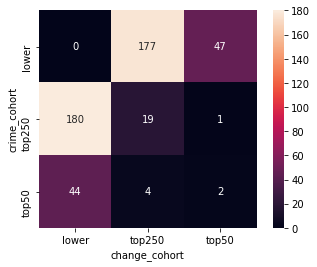

In [63]:
ax = sns.heatmap(
    metrics_change_df, 
    square=True,
    annot=True,
    fmt=",.0f"
)

### Comments
We don't see a pattern of high crime areas also experiencing very high increases in crime between 2017 and 2019 (around 11% were in the top 250 increasing LSOAs)
- note that in this context, lower crime means areas with 2017 crime rates above a threshold (the median) in order to exclude spuriously extreme movements
- also note that the lower crime, lower change segment actually contains 4,353 LSOAs but we set it's value to zero so we didn't obscure other values in the heatmap


### Now plot crime rate versus change in crime between 2017 and 2019
We create two plots:
- A histogram showing percent change by 2017 crime cohort to see broad distribution of change
    - We limit the max percent change to 150% because removing outliers provides a better view of distributions 
- Two scatter plots, one for 2017 v pct_change and the other for 2019 v pct_change. 
    - These interactive plots shows an overall pattern plus lets us drill into see LSOAs of interest

In [99]:
alt.Chart(violent_crime_trends[(violent_crime_trends.total_17_1000 > crime_2017_median) &
                              (violent_crime_trends['pct_change'] < 1.5)]).mark_area(
    opacity=0.6,
    interpolate='step'
).encode(
    alt.X('pct_change:Q', bin=alt.Bin(maxbins=100), axis=alt.Axis(title='% change', ticks=False, format='%', values=[-0.8, 0, 1.0, 2.0, 3.0, 4.0])),
    alt.Y('count()', stack=None, axis=alt.Axis(title='record count', ticks=False, values=[0,20,50, 100, 200])),
    alt.Color('crime_cohort:N')
).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0
)

alt.Chart(...)

In [89]:
chart_2019 = alt.Chart(violent_crime_trends[violent_crime_trends.total_17_1000 > crime_2017_median], title='high crime (2019) vs high changing crime').mark_circle(size=80, opacity=0.6).encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False, format='%', values=[-1.0, 0, 1.0, 2.0, 3.0, 4.0])),
    y=alt.Y('total_19_1000:Q', axis=alt.Axis(title='2019 crime/1000', ticks=False, values=[0,250,500])),
    color='crime_cohort:N',
    tooltip=['lsoa_name', 'pct_change', 'total_19_1000']
).interactive()

chart_2017 = alt.Chart(violent_crime_trends[violent_crime_trends.total_17_1000 > crime_2017_median], title='high crime (2017) vs high changing crime').mark_circle(size=80, opacity=0.6).encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False, format='%', values=[-1.0, 0, 1.0, 2.0, 3.0, 4.0])),
    y=alt.Y('total_17_1000:Q', axis=alt.Axis(title='2017 crime/1000', ticks=False, values=[0,250,500])),
    color='crime_cohort:N',
    tooltip=['lsoa_name', 'pct_change', 'total_17_1000']
).interactive()

(chart_2017 | chart_2019).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0
)

alt.HConcatChart(...)

### Comments
The histogram and the scatter plots confirms what we saw in the heatmap, namely there isn't any obvious pattern that crime increased more in higher crime areas and that the percent change in crime across all crime cohorts was reasonably normally distributed (having removed high outliers and LSOAs with very low 2017 crime rates)

### Look at which LSOAs are in top 50 changers
Now look at the individual LSOAs that were in the top 50 largest changes in crime rates between 2017 and 2019. We identify specific LSOAs because in later notebooks we can look at the associated characteristics for these LSOAs to see if there is anything specific that might have led to these large increases

### get mean increase in crime
We will draw a mean line on our plot (n.b we do have 2017 crime figures where total = 0 so we need to exclude these in order to avoid divide by zero/infinity errors)

In [65]:
mean_val = violent_crime_trends['pct_change'][violent_crime_trends['total_17_1000'] > 0].mean()

print("Mean change in serious violent crime between 2017 and 2019 {0:.2%}".format(mean_val))

Mean change in serious violent crime between 2017 and 2019 20.81%


In [66]:
# Sorting logic inspired by code found at:
# https://stackoverflow.com/questions/62026555/problem-in-sorting-bar-chart-in-altair-that-layered-with-a-mark-text
top_50_changers = violent_crime_trends[violent_crime_trends.total_17_1000 > crime_2017_median].sort_values(by='pct_change', ascending=False)[:50]

bars_10 = alt.Chart(top_50_changers, title='Largest increases or decreases in serious crime (2017-19)').mark_bar(opacity=0.9).encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False, format='%', values=[0, 1.0, 2.0, 3.0, 4.0])),
    y=alt.Y('lsoa_name:N', axis=alt.Axis(title=None, ticks=False), sort=alt.EncodingSortField('value', op='min', order='descending')),
    color='crime_cohort:N'
)

text_10 = alt.Chart(top_50_changers).mark_text(
    align='center',
    baseline='middle',
    color='black',
    dx=20  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    x=alt.X('pct_change:Q', axis=alt.Axis(title='% change', ticks=False)),
    y=alt.Y('lsoa_name:N', axis=alt.Axis(title=None, ticks=False), sort=alt.EncodingSortField('value', op='min', order='descending')),
    text=alt.Text('pct_change:Q', format='.0%')
)

mean_line = alt.Chart().mark_rule(color='firebrick').encode(
    x='a:Q'
)

alt.layer(
    bars_10, text_10, mean_line,
    data=top_50_changers
).transform_calculate(
    a="0.2081", b="50"
).properties(height=700, 
             width=300
).configure_axis(
    grid=False,
    domain=False
).configure_view(
    strokeWidth=0)

alt.LayerChart(...)

## Comments on changes in violent crime
The bar chart provides pretty clear confirmation that there is no pattern of high crime areas also experiencing the highest increase in crime between 2017 and 2019.

In later notebooks we will look at the socio economic characteristics for LSOAs with percent changes above 170%. 
- This is in addition to the analysis we will perform into LSOAs that had high crime but weren't night time economiies such as Havering (Romford), and specific LSOAs within Bexley, Bromley and Croydon. 

## 5. Distribution and Outlier analysis
Having analysed the data we now want to understand in more detail how it is distributed because we need a normally distributed dataset in order to perform our inferential statistics. We start by loading the file we have just saved

In [67]:
london_crimes = pd.read_csv("./DataSources/Crime and outcomes/violent_crimes.csv")

In [68]:
import plotly.express as px

fig = px.box(london_crimes, y="crime_per_1000")
fig.show()

### Outliers 
We know from our prior analysis that certain areas in London dominate the serious violent crime statistics and so it is no surprise to see the extent of these outliers within the box plot. We will now produce histograms and QQ plots for the entire distribution and also for a distribution created by selecting LSOAs whose crime_per_1000 falls between the upper and lower fences identified in the box plot

Serious Violent Crime: Total count = 4,827, while count where crime_per_1000 is less than 26.5 = 4,506


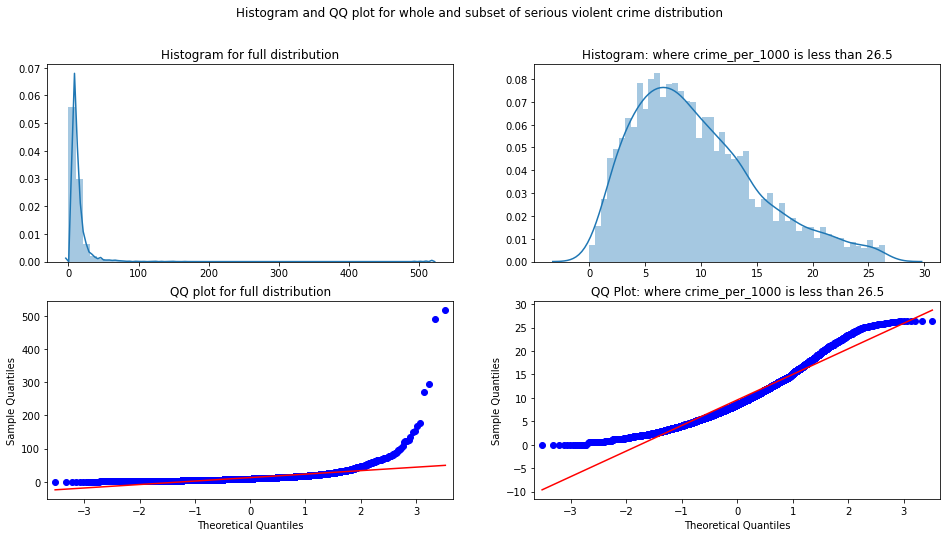

In [69]:
crime_middle_set = london_crimes[london_crimes.crime_per_1000 < 26.5].copy()

print("Serious Violent Crime: Total count = {0:,}, while count where crime_per_1000 is less than 26.5 = {1:,}".format(london_crimes.crime_per_1000.count(), crime_middle_set.crime_per_1000.count()))

f, axes = plt.subplots(2, 2, figsize=(16,8))
f.suptitle('Histogram and QQ plot for whole and subset of serious violent crime distribution')
sns.distplot(np.array(london_crimes.crime_per_1000), bins=50, ax=axes[0,0])
axes[0,0].set_title('Histogram for full distribution')
sm.qqplot(np.array(london_crimes.crime_per_1000), line='r', ax=axes[1,0])
axes[1,0].set_title('QQ plot for full distribution')
sns.distplot(np.array(crime_middle_set.crime_per_1000), bins=50, ax=axes[0,1])
axes[0,1].set_title('Histogram: where crime_per_1000 is less than 26.5')
sm.qqplot(np.array(crime_middle_set.crime_per_1000), line='r', ax=axes[1,1])
axes[1,1].set_title('QQ Plot: where crime_per_1000 is less than 26.5')
plt.show()

## Comments on distribution
The Box plot and histogram confirm what we already knew, which is that the full distribution contains many outliers and these exist within the top 10, 50 and then 250 LSOAs. This creates a very right skewed distribution, with a very long tail. This would cause calculation issues with our inferential statistics because they assume normality in the distribution (well, the pearson correlation does while the spearman can cope better with outliers). However, if we bound our distribution to LSOAs where the crime_per_1000 is less than 26.5, which is the upper fence in the boxplot, we remove the extreme outliers and the remaining distribution is more close to normal. Doing so only removes 321 of 4,827 observations (LSOAs), which is around 6.5% of our overall distribution. This will be our strategy for the inferential statistics.

However, we will be using Random Forests as our classifier and this does not require a normal distribution. We will therefore keep the entire distribution when performing machine learning although we will remove the Westminster LSOAs from that analysis because they aren't residential areas and so not a representative region for our analysis.